#### Libraries

In [22]:
import os
from bs4 import BeautifulSoup
import re
from textblob import TextBlob
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns


#### Data Collection

In [1]:
# This code defines the directory where your XML files are located, lists all files in that directory with a ".xml" extension, and prints the list of transcript files.


# Define the directory containing your XML files
xml_directory = r'C:\Users\asunday\Downloads\Sentiment Analysis\transcripts\transcripts'

# List all XML files in the directory
transcript_files = [file for file in os.listdir(xml_directory) if file.endswith('.xml')]

# Print the list of transcript files
print(transcript_files)

['AAPL_2011_07_19.xml', 'AAPL_2013_04_23.xml', 'ABBV_2013_04_26.xml', 'ABBV_2022_02_02.xml', 'ABT_2010_07_21.xml', 'ABT_2016_02_02.xml', 'ACN_2021_12_16.xml', 'AMD_2012_07_19.xml', 'AMD_2015_01_20.xml', 'AMGN_2018_10_30.xml', 'ANTM_2013_07_24.xml', 'AVGO_2018_09_06.xml', 'AXP_2011_07_20.xml', 'AXP_2021_10_22.xml', 'BAC_2019_04_16.xml', 'BA_2021_07_28.xml', 'BDX_2017_11_02.xml', 'BIIB_2012_10_25.xml', 'BIIB_2014_10_22.xml', 'BIIB_2022_02_03.xml', 'BKNG_2011_05_05.xml', 'BKNG_2019_05_09.xml', 'BMY_2013_01_24.xml', 'BMY_2020_08_06.xml', 'BMY_2021_02_04.xml', 'CB_2011_07_21.xml', 'CB_2012_10_25.xml', 'CB_2014_10_22.xml', 'CB_2017_07_26.xml', 'CB_2022_07_27.xml', 'CHTR_2022_07_29.xml', 'CI_2013_10_31.xml', 'COP_2017_08_03.xml', 'COP_2018_05_03.xml', 'COP_2019_08_08.xml', 'CRM_2011_11_17.xml', 'CRM_2013_02_28.xml', 'CRM_2022_08_24.xml', 'CSCO_2011_05_11.xml', 'CVS_2017_11_06.xml', 'C_2012_10_15.xml', 'C_2018_04_13.xml', 'DAL_2013_04_23.xml', 'DAL_2022_10_13.xml', 'DD_2017_07_25.xml', 'DD_201

#### Data Preprocessing

In [3]:
# We create a clean_text function to preprocess the text data, which includes removing HTML tags, converting text to lowercase, 
# removing punctuation and special characters, and eliminating extra whitespaces.

# We create a dictionary called cleaned_transcripts to store the cleaned transcripts.

# We loop through each XML file in the directory, extract the text content, clean it using the clean_text function, 
#and store the cleaned transcript in the cleaned_transcripts dictionary with the file name as the key.


# Create a function to preprocess the text data
def clean_text(text):
    # Remove HTML tags using BeautifulSoup
    text = BeautifulSoup(text, 'html.parser').get_text()
    # Convert text to lowercase
    text = text.lower()
    # Remove punctuation and special characters
    text = re.sub(r'[^a-zA-Z0-9\s]', '', text)
    # Remove extra whitespaces
    text = ' '.join(text.split())
    return text

# Create a dictionary to store cleaned transcripts
cleaned_transcripts = {}

# Loop through each XML file and preprocess the data
for filename in os.listdir(xml_directory):
    if filename.endswith('.xml'):
        with open(os.path.join(xml_directory, filename), 'r', encoding='utf-8') as file:
            xml_content = file.read()
        
        # Extract the text content from the XML
        soup = BeautifulSoup(xml_content, 'xml')
        transcript_text = soup.get_text()
        
        # Clean the text data
        cleaned_transcript = clean_text(transcript_text)
        
        # Store the cleaned transcript in the dictionary with the file name as the key
        cleaned_transcripts[filename] = cleaned_transcript

In [68]:
cleaned_transcripts

{'AAPL_2011_07_19.xml': 'edited transcript of aapl earnings conference call or presentation 19jul11 900pm gmt q3 2011 apple inc earnings conference call cupertino jul 20 2011 thomson streetevents edited transcript of apple inc earnings conference call or presentation tuesday july 19 2011 at 90000pm gmt text version of transcript corporate participants nancy paxton apple computer inc senior director ir peter oppenheimer apple computer inc svp cfo tim cook apple computer inc coo conference call participants katy huberty morgan stanley analyst shannon cross cross research analyst benjamin reitzes barclays capital analyst bill shope goldman sachs analyst richard gardner citigroup analyst gene munster piper jaffray analyst mark moskowitz jpmorgan analyst mike abramsky rbc capital markets analyst keith bachman bank of montreal analyst scott craig bank of america analyst brian blair wedge partners analyst toni sacconaghi sanford bernstein analyst brian marshall gleacher company analyst presen

#### Company Ticker Symbols and Names

In [6]:
# we've created a dictionary ticker_to_company that associates ticker symbols with company names.
# this information will be used to identify and associate transcripts with specific companies in the subsequent steps.

# Define a dictionary mapping ticker symbols to company names
ticker_to_company = {
    'NOW': 'ServiceNow Inc.',
    'ZTS': 'Zoetis Inc.',
    'PAYC': 'Paycom Software Inc.',
    'CMCSA': 'Comcast Corporation',
    'MXIM': 'Maxim Integrated Products Inc.',
    'PRU': 'Prudential Financial Inc.',
    'ITW': 'Illinois Tool Works Inc.',
    'KSU': 'Kansas City Southern',
    'HRL': 'Hormel Foods Corporation',
    'EQIX': 'Equinix Inc.',
    'M': 'Macy\'s Inc.',
    'ODFL': 'Old Dominion Freight Line Inc.',
    'IEX': 'IDEX Corporation',
    'PSA': 'Public Storage',
    'JNJ': 'Johnson & Johnson',
    'BA': 'The Boeing Company',
    'PCAR': 'PACCAR Inc.',
    'BLK': 'BlackRock Inc.',
    'CAT': 'Caterpillar Inc.',
    'IVZ': 'Invesco Ltd.',
    'TMO': 'Thermo Fisher Scientific Inc.',
    'PG': 'Procter & Gamble Company',
    'XOM': 'Exxon Mobil Corporation',
    'JNPR': 'Juniper Networks Inc.',
    'FOXA': 'Fox Corporation',
    'DE': 'Deere & Company',
    'MLM': 'Martin Marietta Materials Inc.',
    'NI': 'NiSource Inc.',
    'C': 'Citigroup Inc.',
    'OKE': 'ONEOK Inc.',
    'KEY': 'KeyCorp',
    'PKI': 'PerkinElmer Inc.',
    'PEAK': 'Healthpeak Properties Inc.',
    'DD': 'DuPont de Nemours Inc.',
    'IT': 'Gartner Inc.',
    'HON': 'Honeywell International Inc.',
    'CVS': 'CVS Health Corporation',
    'UNH': 'UnitedHealth Group Inc.',
    'MDLZ': 'Mondelez International Inc.',
    'NWL': 'Newell Brands Inc.',
    'AAPL': 'Apple Inc.',
    'HSY': 'The Hershey Company',
    'PGR': 'The Progressive Corporation',
    'MAR': 'Marriott International Inc.',
    'MHK': 'Mohawk Industries Inc.',
    'MOH': 'Molina Healthcare Inc.',
    'MNST': 'Monster Beverage Corporation',
    'LUV': 'Southwest Airlines Co.',
    'IBM': 'International Business Machines Corporation',
    'SO': 'Southern Company',
    'FITB': 'Fifth Third Bancorp',
    'PPL': 'PPL Corporation',
    'LKQLRCX': 'L Brands Inc.',
    'PFG': 'Principal Financial Group Inc.',
    'KMB': 'Kimberly-Clark Corporation',
    'NWS': 'News Corporation',
    'LH': 'Labcorp',
    'LLY': 'Eli Lilly and Company',
    'BIIB': 'Biogen Inc.',
    'HRB': 'H&R Block Inc.',
    'BMY': 'Bristol-Myers Squibb Company',
    'MSI': 'Motorola Solutions Inc.',
    'F': 'Ford Motor Company',
    'MS': 'Morgan Stanley',
    'EXC': 'Exelon Corporation',
    'ISRG': 'Intuitive Surgical Inc.',
    'INFO': 'IHS Markit Ltd.',
    'COST': 'Costco Wholesale Corporation',
    'MMM': '3M Company',
    'FDX': 'FedEx Corporation',
    'MCK': 'McKesson Corporation',
    'DAL': 'Delta Air Lines Inc.',
    'GS': 'The Goldman Sachs Group Inc.',
    'KIM': 'Kimco Realty Corporation',
    'IQV': 'IQVIA Holdings Inc.',
    'BKNG': 'Booking Holdings Inc.',
    'MAS': 'Masco Corporation',
    'INCY': 'Incyte Corporation',
    'NEM': 'Newmont Corporation',
    'L': 'Loews Corporation',
    'DUK': 'Duke Energy Corporation',
    'PM': 'Philip Morris International Inc.',
    'MOS': 'The Mosaic Company',
    'PRGO': 'Perrigo Company plc',
    'NUE': 'Nucor Corporation',
    'ANTM': 'Anthem Inc.',
    'HAS': 'Hasbro Inc.',
    'GD': 'General Dynamics Corporation',
    'JWN': 'Nordstrom Inc.',
    'LIN': 'Linde plc',
    'NTRS': 'Northern Trust Corporation',
    'HCA': 'HCA Healthcare Inc.',
    'BAC': 'Bank of America Corporation',
    'ADBE': 'Adobe Inc.',
    'SYK': 'Stryker Corporation',
    'HSIC': 'Henry Schein Inc.',
    'BDX': 'Becton, Dickinson and Company',
    'PEP': 'PepsiCo Inc.',
    'SBUX': 'Starbucks Corporation',
    'MCO': 'Moody\'s Corporation'
}

#### Identify Companies of Interest

In [7]:
# Define a list of ticker symbols for companies of interest
companies_of_interest = ['NOW', 'ZTS', 'PAYC', 'CMCSA', 'MXIM', 'PRU', 'ITW', 'KSU', 'HRL', 'EQIX', 'M', 'ODFL', 'IEX', 'PSA', 'JNJ', 'BA', 'PCAR', 'BLK', 'CAT', 'IVZ', 'TMO', 'PG', 'XOM', 'JNPR', 'FOXA', 'DE', 'MLM', 'NI', 'C', 'OKE', 'KEY', 'PKI', 'PEAK', 'DD', 'IT', 'HON', 'CVS', 'UNH', 'MDLZ', 'NWL', 'AAPL', 'HSY', 'PGR', 'MAR', 'MHK', 'MOH', 'MNST', 'LUV', 'IBM', 'SO', 'FITB', 'PPL', 'LKQLRCX', 'PFG', 'KMB', 'NWS', 'LH', 'LLY', 'BIIB', 'HRB', 'BMY', 'MSI', 'F', 'MS', 'EXC', 'ISRG', 'INFO', 'COST', 'MMM', 'FDX', 'MCK', 'DAL', 'GS', 'KIM', 'IQV', 'BKNG', 'MAS', 'INCY', 'NEM', 'L', 'DUK', 'PM', 'MOS', 'PRGO', 'NUE', 'ANTM', 'HAS', 'GD', 'JWN', 'LIN', 'NTRS', 'HCA', 'BAC', 'ADBE', 'SYK', 'HSIC', 'BDX', 'PEP', 'SBUX', 'MCO']

#### Data Association

In [13]:
# We create a dictionary called company_transcripts to associate transcripts with company names.
# We loop through the cleaned transcripts, and for each transcript, we extract the ticker symbol from the filename. We assume that the ticker symbol is the first part of the filename before ".xml".
# We use the ticker_to_company dictionary to get the corresponding company name based on the ticker symbol.
# We check if the company is one of the companies of interest by looking for the ticker symbol in the companies_of_interest list.
# If the company is one of the companies of interest, we append the cleaned transcript to the list associated with that company in the company_transcripts dictionary.


# Create a dictionary to associate transcripts with company names
company_transcripts = {}

# Loop through the cleaned transcripts and associate them with companies
for filename, cleaned_transcript in cleaned_transcripts.items():
    # Extract the ticker symbol from the filename (before the first underscore)
    ticker_symbol = filename.split("_")[0]
    # Get the company name from the 'ticker_to_company' dictionary
    company_name = ticker_to_company.get(ticker_symbol, None)

    # Check if the company is one of the companies of interest
    if company_name and ticker_symbol in companies_of_interest:
        # Create a list of transcripts for the company
        if company_name not in company_transcripts:
            company_transcripts[company_name] = []
        company_transcripts[company_name].append(cleaned_transcript)

# Now, 'company_transcripts' associates each company name with its cleaned transcripts

In [14]:
company_transcripts

{'Apple Inc.': ['edited transcript of aapl earnings conference call or presentation 19jul11 900pm gmt q3 2011 apple inc earnings conference call cupertino jul 20 2011 thomson streetevents edited transcript of apple inc earnings conference call or presentation tuesday july 19 2011 at 90000pm gmt text version of transcript corporate participants nancy paxton apple computer inc senior director ir peter oppenheimer apple computer inc svp cfo tim cook apple computer inc coo conference call participants katy huberty morgan stanley analyst shannon cross cross research analyst benjamin reitzes barclays capital analyst bill shope goldman sachs analyst richard gardner citigroup analyst gene munster piper jaffray analyst mark moskowitz jpmorgan analyst mike abramsky rbc capital markets analyst keith bachman bank of montreal analyst scott craig bank of america analyst brian blair wedge partners analyst toni sacconaghi sanford bernstein analyst brian marshall gleacher company analyst presentation o

#### Sentiment Analysis with TextBlob

At the core of sentiment analysis lies the concept of "polarity." Polarity is a numeric value assigned to a piece of text, indicating whether the sentiment expressed is positive, negative, or neutral. This value can help us comprehend the emotional tone of the text, making it an essential component of sentiment analysis.

In sentiment analysis, polarity typically ranges between -1 and 1, representing the full spectrum of sentiments:

Positive Polarity (1): Text with a positive sentiment expresses favorable opinions, happiness, or approval. For instance, consider the sentence: "I love this product; it's amazing!" In this case, the polarity is close to 1, signifying a strongly positive sentiment.

Neutral Polarity (0): Text with a neutral sentiment conveys a lack of strong emotion or opinions, often stating factual information. For example, "The weather today is 25°C," is a neutral statement with a polarity value near 0.

Negative Polarity (-1): Conversely, text with a negative sentiment represents unfavorable views, dissatisfaction, or disappointment. An example sentence with negative polarity might be: "The customer service was terrible; I'm very upset." Here, the polarity is close to -1, indicating a strongly negative sentiment.

In [16]:
# Here we have created a function that takes a text as input and returns the sentiment polarity and subjectivity. 
# The polarity ranges from -1 (most negative) to 1 (most positive), 
# while subjectivity ranges from 0 (objective) to 1 (subjective).

def analyze_sentiment(text):
    analysis = TextBlob(text)
    # Determine sentiment polarity (positive, negative, neutral)
    if analysis.sentiment.polarity > 0:
        sentiment = "positive"
    elif analysis.sentiment.polarity < 0:
        sentiment = "negative"
    else:
        sentiment = "neutral"
    # Return sentiment and polarity
    return sentiment, analysis.sentiment.polarity

In [18]:
# Create a dictionary to store sentiment results for each transcript
sentiment_results = {}

for company, transcripts in company_transcripts.items():
    sentiment_results[company] = []
    for transcript in transcripts:
        sentiment, polarity = analyze_sentiment(transcript)
        sentiment_results[company].append((sentiment, polarity))


# The analyze_sentiment function is used to analyze the sentiment of each transcript, 
# and the results are stored in a dictionary called sentiment_results. 
# The dictionary associates each company with its sentiment results, including sentiment (positive, negative, or neutral) and polarity.

In [20]:
print(sentiment_results)

{'Apple Inc.': [('positive', 0.21971278569283262), ('positive', 0.20465993958792303)], 'Anthem Inc.': [('positive', 0.11866475655818298)], 'Bank of America Corporation': [('positive', 0.11697080174727247)], 'The Boeing Company': [('positive', 0.1345594084326287)], 'Becton, Dickinson and Company': [('positive', 0.12595051956325262)], 'Biogen Inc.': [('positive', 0.10345754842766804), ('positive', 0.14465925536113686), ('positive', 0.10099365128446769)], 'Booking Holdings Inc.': [('positive', 0.135977421271539), ('positive', 0.13206127513701407)], 'Bristol-Myers Squibb Company': [('positive', 0.1630860398697302), ('positive', 0.16204021219628156), ('positive', 0.1502509367123101)], 'CVS Health Corporation': [('positive', 0.13150278614430735)], 'Citigroup Inc.': [('positive', 0.08740076385909742), ('positive', 0.13311785823096742)], 'Delta Air Lines Inc.': [('positive', 0.1644381908086097), ('positive', 0.15412865202262666)], 'DuPont de Nemours Inc.': [('positive', 0.10193534969304197), (

#### Analysis and Visualization

In [24]:
# some companies have a different number of transcripts so we are going to aggregate the polarities so that we have one polarity per company

# Initialize an empty dictionary to store aggregated sentiment data
aggregated_sentiment = {
    'Company': [],  # Create a list to store company names
    'Average_Polarity': []  # Create a list to store average polarities
}

# Loop through company_transcripts to aggregate sentiment data
for company, transcripts in company_transcripts.items():
    polarities = [result[1] for result in sentiment_results[company]]
    average_polarity = sum(polarities) / len(polarities) if len(polarities) > 0 else 0  # Calculate average polarity
    aggregated_sentiment['Company'].append(company)
    aggregated_sentiment['Average_Polarity'].append(average_polarity)


# Here, we calculate the average polarity for each company based on the available sentiment results. 
# This ensures that the DataFrame is created with equal-length arrays and without errors.

In [25]:
print(aggregated_sentiment)

{'Company': ['Apple Inc.', 'Anthem Inc.', 'Bank of America Corporation', 'The Boeing Company', 'Becton, Dickinson and Company', 'Biogen Inc.', 'Booking Holdings Inc.', 'Bristol-Myers Squibb Company', 'CVS Health Corporation', 'Citigroup Inc.', 'Delta Air Lines Inc.', 'DuPont de Nemours Inc.', 'Deere & Company', 'Equinix Inc.', 'Exelon Corporation', 'FedEx Corporation', 'Fifth Third Bancorp', 'General Dynamics Corporation', 'The Goldman Sachs Group Inc.', 'Hasbro Inc.', 'HCA Healthcare Inc.', 'Honeywell International Inc.', 'Hormel Foods Corporation', 'Henry Schein Inc.', 'International Business Machines Corporation', 'Incyte Corporation', 'Intuitive Surgical Inc.', 'Illinois Tool Works Inc.', 'Gartner Inc.', 'Invesco Ltd.', 'Juniper Networks Inc.', 'Nordstrom Inc.', 'KeyCorp', 'Kimco Realty Corporation', 'Kimberly-Clark Corporation', 'Kansas City Southern', 'Labcorp', 'Linde plc', 'Eli Lilly and Company', 'Southwest Airlines Co.', 'Loews Corporation', 'Marriott International Inc.', 'Mc

In [40]:
# Create a DataFrame from the aggregated sentiment data
df = pd.DataFrame(aggregated_sentiment)

df.shape

(68, 2)

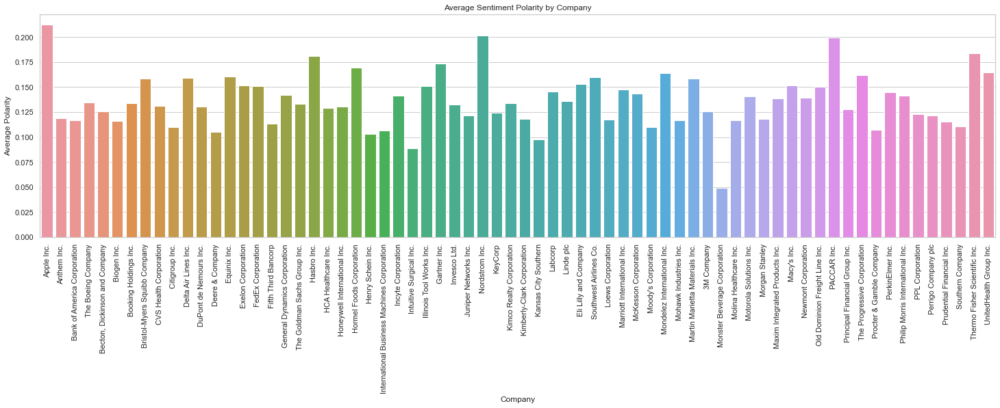

In [37]:
# Set the style of the plot (optional)
sns.set(style="whitegrid")

# Create a bar plot for average sentiment polarity
plt.figure(figsize=(25, 6))
sns.barplot(x="Company", y="Average_Polarity", data=df)
plt.title("Average Sentiment Polarity by Company")
plt.ylabel("Average Polarity")
plt.xlabel("Company")
plt.xticks(rotation=90)
plt.show()

#### Industry Benchmarking

In [50]:
# create a list of industry classification for the companies in our dataframe based on general industry categorizations commonly used in financial and economic analysis.

industries = [
    "Technology (Consumer Electronics)",
    "Healthcare (Health Insurance)",
    "Banking and Financial Services",
    "Aerospace and Defense",
    "Medical Technology",
    "Biotechnology",
    "Travel and Online Reservations",
    "Pharmaceuticals",
    "Healthcare (Pharmacy and Health Services)",
    "Banking and Financial Services",
    "Airlines",
    "Chemicals",
    "Agriculture and Machinery",
    "Technology (Data Centers)",
    "Energy (Utilities)",
    "Logistics and Courier Services",
    "Banking and Financial Services",
    "Aerospace and Defense",
    "Banking and Financial Services",
    "Toy and Entertainment",
    "Healthcare (Hospital and Medical Services)",
    "Technology (Aerospace and Industrial)",
    "Food (Processed Meat)",
    "Healthcare (Dental and Medical Supplies)",
    "Technology (IT Services and Solutions)",
    "Biotechnology",
    "Medical Robotics",
    "Manufacturing and Engineering",
    "Research and Advisory Services",
    "Financial Services (Asset Management)",
    "Technology (Networking Equipment)",
    "Retail (Department Stores)",
    "Banking and Financial Services",
    "Real Estate (REIT)",
    "Consumer Goods (Paper Products)",
    "Transportation (Railroads)",
    "Healthcare (Clinical Diagnostics)",
    "Industrial Gases",
    "Pharmaceuticals",
    "Airlines",
    "Conglomerate (Diversified Holdings)",
    "Hospitality (Hotels and Resorts)",
    "Healthcare (Pharmaceutical Distribution)",
    "Financial Services (Credit Ratings)",
    "Food (Snack and Confectionery)",
    "Manufacturing (Flooring)",
    "Construction Materials",
    "Conglomerate (Diversified Manufacturing)",
    "Food and Beverages (Energy Drinks)",
    "Healthcare (Managed Care)",
    "Technology (Communication Solutions)",
    "Banking and Financial Services",
    "Technology (Semiconductor)",
    "Retail (Department Stores)",
    "Mining (Gold and Metals)",
    "Transportation (Trucking)",
    "Manufacturing (Truck and Engine)",
    "Financial Services (Asset Management and Insurance)",
    "Insurance (Auto and Home)",
    "Consumer Goods (Consumer Packaged Goods)",
    "Technology (Scientific Equipment)",
    "Tobacco",
    "Energy (Utilities)",
    "Pharmaceuticals (Generic Drugs)",
    "Financial Services (Insurance and Investment)",
    "Energy (Utilities)",
    "Healthcare and Technology (Scientific Research)",
    "Healthcare (Health Insurance and Services)"
]


In [51]:
# add a new column called Industry_Category to dataframe

df['Industry_Category'] = industries

df.head(10)


,Company,Average_Polarity,Industry_Category
0,Apple Inc.,0.212186,Technology (Consumer Electronics)
1,Anthem Inc.,0.118665,Healthcare (Health Insurance)
2,Bank of America Corporation,0.116971,Banking and Financial Services
3,The Boeing Company,0.134559,Aerospace and Defense
4,"Becton, Dickinson and Company",0.125951,Medical Technology
5,Biogen Inc.,0.116370,Biotechnology
6,Booking Holdings Inc.,0.134019,Travel and Online Reservations
7,Bristol-Myers Squibb Company,0.158459,Pharmaceuticals
8,CVS Health Corporation,0.131503,Healthcare (Pharmacy and Health Services)
9,Citigroup Inc.,0.110259,Banking and Financial Services


In [63]:
# Group the data by industry category and calculate the average polarity

industry_sentiment = df.groupby('Industry_Category')['Average_Polarity'].mean().reset_index()

industry_sentiment.head()

,Industry_Category,Average_Polarity
0,Aerospace and Defense,0.138179
1,Agriculture and Machinery,0.104907
2,Airlines,0.159715
3,Banking and Financial Services,0.119489
4,Biotechnology,0.128967


In [64]:
# Lets sort the industry sentiment in descending order by average polarity
industry_sentiment = industry_sentiment.sort_values(by='Average_Polarity', ascending=False)



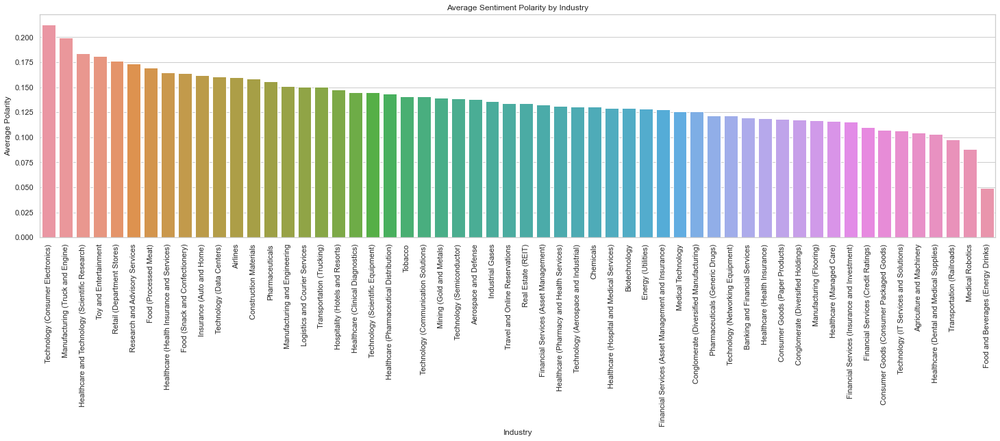

In [65]:
# Set the style (optional)
sns.set(style="whitegrid")

# Create a bar plot for average sentiment by industry
plt.figure(figsize=(25, 6))
sns.barplot(x="Industry_Category", y="Average_Polarity", data=industry_sentiment)
plt.title("Average Sentiment Polarity by Industry")
plt.ylabel("Average Polarity")
plt.xlabel("Industry")
plt.xticks(rotation=90)
plt.show()